# Brain Tumor Classification (MRI)

Dataset utilizado do kaggle: https://www.kaggle.com/datasets/sartajbhuvaji/brain-tumor-classification-mri/data

* 3264 imagens em JPG

* 4 classes: glioma_tumor, meningioma_tumor, no_tumor, pituitary_tumor

#Importação das bibliotecas e classe Architecture

In [ ]:
# Import standard libraries for randomness, deep copying, and numerical operations
import random
import numpy as np
from copy import deepcopy

# Import libraries for image processing and data manipulation
from PIL import Image
import pandas as pd

# Import PyTorch core and utilities for deep learning
import torch
import torch.optim as optim  # Optimization algorithms
import torch.nn as nn  # Neural network modules
import torch.nn.functional as F  # Functional API for non-parametric operations

# Import PyTorch utilities for data loading and transformations
from torch.utils.data import DataLoader, Dataset, random_split, WeightedRandomSampler
from torchvision.transforms.v2 import Compose, ToImage, Normalize, ToPILImage, Resize, ToDtype

# Import dataset handling and learning rate schedulers
from torchvision.datasets import ImageFolder
from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau, MultiStepLR, CyclicLR, LambdaLR

# Import visualization and web utilities
import matplotlib.pyplot as plt
import requests
import zipfile
import os
import errno

# Set matplotlib style for better visuals
plt.style.use('fivethirtyeight')

## Architecture class

In [ ]:
class Architecture(object):
    def __init__(self, model, loss_fn, optimizer):
        # Here we define the attributes of our class

        # We start by storing the arguments as attributes
        # to use them later
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        # Let's send the model to the specified device right away
        self.model.to(self.device)

        # These attributes are defined here, but since they are
        # not informed at the moment of creation, we keep them None
        self.train_loader = None
        self.val_loader = None

        # These attributes are going to be computed internally
        self.losses = []
        self.val_losses = []
        self.total_epochs = 0

        # Creates the train_step function for our model,
        # loss function and optimizer
        # Note: there are NO ARGS there! It makes use of the class
        # attributes directly
        self.train_step_fn = self._make_train_step_fn()
        # Creates the val_step function for our model and loss
        self.val_step_fn = self._make_val_step_fn()

        # for hook purposes
        self.handles = {}
        self.visualization = {}

    def to(self, device):
        # This method allows the user to specify a different device
        # It sets the corresponding attribute (to be used later in
        # the mini-batches) and sends the model to the device
        try:
            self.device = device
            self.model.to(self.device)
        except RuntimeError:
            self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
            print(f"Couldn't send it to {device}, sending it to {self.device} instead.")
            self.model.to(self.device)

    def set_loaders(self, train_loader, val_loader=None):
        # This method allows the user to define which train_loader (and val_loader, optionally) to use
        # Both loaders are then assigned to attributes of the class
        # So they can be referred to later
        self.train_loader = train_loader
        self.val_loader = val_loader

    def _make_train_step_fn(self):
        # This method does not need ARGS... it can refer to
        # the attributes: self.model, self.loss_fn and self.optimizer

        # Builds function that performs a step in the train loop
        def perform_train_step_fn(x, y):
            # Sets model to TRAIN mode
            self.model.train()

            # Step 1 - Computes our model's predicted output - forward pass
            yhat = self.model(x)
            # Step 2 - Computes the loss
            loss = self.loss_fn(yhat, y)
            # Step 3 - Computes gradients for both "a" and "b" parameters
            loss.backward()
            # Step 4 - Updates parameters using gradients and the learning rate
            self.optimizer.step()
            self.optimizer.zero_grad()

            # Returns the loss
            return loss.item()

        # Returns the function that will be called inside the train loop
        return perform_train_step_fn

    def _make_val_step_fn(self):
        # Builds function that performs a step in the validation loop
        def perform_val_step_fn(x, y):
            # Sets model to EVAL mode
            self.model.eval()

            # Step 1 - Computes our model's predicted output - forward pass
            yhat = self.model(x)
            # Step 2 - Computes the loss
            loss = self.loss_fn(yhat, y)
            # There is no need to compute Steps 3 and 4, since we don't update parameters during evaluation
            return loss.item()

        return perform_val_step_fn

    def _mini_batch(self, validation=False):
        # The mini-batch can be used with both loaders
        # The argument `validation`defines which loader and
        # corresponding step function is going to be used
        if validation:
            data_loader = self.val_loader
            step_fn = self.val_step_fn
        else:
            data_loader = self.train_loader
            step_fn = self.train_step_fn

        if data_loader is None:
            return None

        # Once the data loader and step function, this is the same
        # mini-batch loop we had before
        mini_batch_losses = []
        for x_batch, y_batch in data_loader:
            x_batch = x_batch.to(self.device)
            y_batch = y_batch.to(self.device)

            mini_batch_loss = step_fn(x_batch, y_batch)
            mini_batch_losses.append(mini_batch_loss)

        loss = np.mean(mini_batch_losses)
        return loss

    # this function was updated in this class
    def set_seed(self, seed=42):
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False
        torch.manual_seed(seed)
        np.random.seed(seed)
        random.seed(seed)
        try:
            self.train_loader.sampler.generator.manual_seed(seed)
        except AttributeError:
            pass

    def train(self, n_epochs, seed=42):
        # To ensure reproducibility of the training process
        self.set_seed(seed)

        for epoch in range(n_epochs):
            # Keeps track of the numbers of epochs
            # by updating the corresponding attribute
            self.total_epochs += 1

            # inner loop
            # Performs training using mini-batches
            loss = self._mini_batch(validation=False)
            self.losses.append(loss)

            # VALIDATION
            # no gradients in validation!
            with torch.no_grad():
                # Performs evaluation using mini-batches
                val_loss = self._mini_batch(validation=True)
                self.val_losses.append(val_loss)

    def save_checkpoint(self, filename):
        # Builds dictionary with all elements for resuming training
        checkpoint = {'epoch': self.total_epochs,
                      'model_state_dict': self.model.state_dict(),
                      'optimizer_state_dict': self.optimizer.state_dict(),
                      'loss': self.losses,
                      'val_loss': self.val_losses}

        torch.save(checkpoint, filename)

    def load_checkpoint(self, filename):
        # Loads dictionary
        checkpoint = torch.load(filename)

        # Restore state for model and optimizer
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

        self.total_epochs = checkpoint['epoch']
        self.losses = checkpoint['loss']
        self.val_losses = checkpoint['val_loss']

        self.model.train() # always use TRAIN for resuming training

    def predict(self, x):
        # Set is to evaluation mode for predictions
        self.model.eval()
        # Takes aNumpy input and make it a float tensor
        x_tensor = torch.as_tensor(x).float()
        # Send input to device and uses model for prediction
        y_hat_tensor = self.model(x_tensor.to(self.device))
        # Set it back to train mode
        self.model.train()
        # Detaches it, brings it to CPU and back to Numpy
        return y_hat_tensor.detach().cpu().numpy()

    def count_parameters(self):
      return sum(p.numel() for p in self.model.parameters() if p.requires_grad)

    def plot_losses(self):
        fig = plt.figure(figsize=(10, 4))
        plt.plot(self.losses, label='Training Loss', c='b')
        plt.plot(self.val_losses, label='Validation Loss', c='r')
        plt.yscale('log')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.tight_layout()
        return fig

    @staticmethod
    def _visualize_tensors(axs, x, y=None, yhat=None, layer_name='', title=None):
        # The number of images is the number of subplots in a row
        n_images = len(axs)
        # Gets max and min values for scaling the grayscale
        minv, maxv = np.min(x[:n_images]), np.max(x[:n_images])
        # For each image
        for j, image in enumerate(x[:n_images]):
            ax = axs[j]
            # Sets title, labels, and removes ticks
            if title is not None:
                ax.set_title(f'{title} #{j}', fontsize=12)
            shp = np.atleast_2d(image).shape
            ax.set_ylabel(
                f'{layer_name}\n{shp[0]}x{shp[1]}',
                rotation=0, labelpad=40
            )
            xlabel1 = '' if y is None else f'\nLabel: {y[j]}'
            xlabel2 = '' if yhat is None else f'\nPredicted: {yhat[j]}'
            xlabel = f'{xlabel1}{xlabel2}'
            if len(xlabel):
                ax.set_xlabel(xlabel, fontsize=12)
            ax.set_xticks([])
            ax.set_yticks([])

            # Plots weight as an image
            ax.imshow(
                np.atleast_2d(image.squeeze()),
                cmap='gray',
                vmin=minv,
                vmax=maxv
            )
        return

    def visualize_filters(self, layer_name, **kwargs):
        try:
            # Gets the layer object from the model
            layer = self.model
            for name in layer_name.split('.'):
                layer = getattr(layer, name)
            # We are only looking at filters for 2D convolutions
            if isinstance(layer, nn.Conv2d):
                # Takes the weight information
                weights = layer.weight.data.cpu().numpy()
                # weights -> (channels_out (filter), channels_in, H, W)
                n_filters, n_channels, _, _ = weights.shape

                # Builds a figure
                size = (2 * n_channels + 2, 2 * n_filters)
                fig, axes = plt.subplots(n_filters, n_channels,
                                        figsize=size)
                axes = np.atleast_2d(axes)
                axes = axes.reshape(n_filters, n_channels)
                # For each channel_out (filter)
                for i in range(n_filters):
                    Architecture._visualize_tensors(
                        axes[i, :],
                        weights[i],
                        layer_name=f'Filter #{i}',
                        title='Channel'
                    )

                for ax in axes.flat:
                    ax.label_outer()

                fig.tight_layout()
                return fig
        except AttributeError:
            return

    def attach_hooks(self, layers_to_hook, hook_fn=None):
        # Clear any previous values
        self.visualization = {}
        # Creates the dictionary to map layer objects to their names
        modules = list(self.model.named_modules())
        layer_names = {layer: name for name, layer in modules[1:]}

        if hook_fn is None:
            # Hook function to be attached to the forward pass
            def hook_fn(layer, inputs, outputs):
                # Gets the layer name
                name = layer_names[layer]
                # Detaches outputs
                values = outputs.detach().cpu().numpy()
                # Since the hook function may be called multiple times
                # for example, if we make predictions for multiple mini-batches
                # it concatenates the results
                if self.visualization[name] is None:
                    self.visualization[name] = values
                else:
                    self.visualization[name] = np.concatenate([self.visualization[name], values])

        for name, layer in modules:
            # If the layer is in our list
            if name in layers_to_hook:
                # Initializes the corresponding key in the dictionary
                self.visualization[name] = None
                # Register the forward hook and keep the handle in another dict
                self.handles[name] = layer.register_forward_hook(hook_fn)

    def remove_hooks(self):
        # Loops through all hooks and removes them
        for handle in self.handles.values():
            handle.remove()
        # Clear the dict, as all hooks have been removed
        self.handles = {}

    def visualize_outputs(self, layers, n_images=10, y=None, yhat=None):
        layers = filter(lambda l: l in self.visualization.keys(), layers)
        layers = list(layers)
        shapes = [self.visualization[layer].shape for layer in layers]
        n_rows = [shape[1] if len(shape) == 4 else 1
                  for shape in shapes]
        total_rows = np.sum(n_rows)

        fig, axes = plt.subplots(total_rows, n_images,
                                figsize=(1.5*n_images, 1.5*total_rows))
        axes = np.atleast_2d(axes).reshape(total_rows, n_images)

        # Loops through the layers, one layer per row of subplots
        row = 0
        for i, layer in enumerate(layers):
            start_row = row
            # Takes the produced feature maps for that layer
            output = self.visualization[layer]

            is_vector = len(output.shape) == 2

            for j in range(n_rows[i]):
                Architecture._visualize_tensors(
                    axes[row, :],
                    output if is_vector else output[:, j].squeeze(),
                    y,
                    yhat,
                    layer_name=layers[i] \
                              if is_vector \
                              else f'{layers[i]}\nfil#{row-start_row}',
                    title='Image' if (row == 0) else None
                )
                row += 1

        for ax in axes.flat:
            ax.label_outer()

        plt.tight_layout()
        return fig

    def correct(self, x, y, threshold=.5):
        self.model.eval()
        yhat = self.model(x.to(self.device))
        y = y.to(self.device)
        self.model.train()

        # We get the size of the batch and the number of classes
        # (only 1, if it is binary)
        n_samples, n_dims = yhat.shape
        if n_dims > 1:
            # In a multiclass classification, the biggest logit
            # always wins, so we don't bother getting probabilities

            # This is PyTorch's version of argmax,
            # but it returns a tuple: (max value, index of max value)
            _, predicted = torch.max(yhat, 1)
        else:
            n_dims += 1
            # In binary classification, we NEED to check if the
            # last layer is a sigmoid (and then it produces probs)
            if isinstance(self.model, nn.Sequential) and \
              isinstance(self.model[-1], nn.Sigmoid):
                predicted = (yhat > threshold).long()
            # or something else (logits), which we need to convert
            # using a sigmoid
            else:
                predicted = (F.sigmoid(yhat) > threshold).long()

        # How many samples got classified correctly for each class
        result = []
        for c in range(n_dims):
            n_class = (y == c).sum().item()
            n_correct = (predicted[y == c] == c).sum().item()
            result.append((n_correct, n_class))
        return torch.tensor(result)


    @staticmethod
    def loader_apply(loader, func, reduce='sum'):
        results = [func(x, y) for i, (x, y) in enumerate(loader)]
        results = torch.stack(results, axis=0)

        if reduce == 'sum':
            results = results.sum(axis=0)
        elif reduce == 'mean':
            results = results.float().mean(axis=0)

        return results

    @staticmethod
    def statistics_per_channel(images, labels):
        # NCHW
        n_samples, n_channels, n_height, n_weight = images.size()
        # Flatten HW into a single dimension
        flatten_per_channel = images.reshape(n_samples, n_channels, -1)

        # Computes statistics of each image per channel
        # Average pixel value per channel
        # (n_samples, n_channels)
        means = flatten_per_channel.mean(axis=2)
        # Standard deviation of pixel values per channel
        # (n_samples, n_channels)
        stds = flatten_per_channel.std(axis=2)

        # Adds up statistics of all images in a mini-batch
        # (1, n_channels)
        sum_means = means.sum(axis=0)
        sum_stds = stds.sum(axis=0)
        # Makes a tensor of shape (1, n_channels)
        # with the number of samples in the mini-batch
        n_samples = torch.tensor([n_samples]*n_channels).float()

        # Stack the three tensors on top of one another
        # (3, n_channels)
        return torch.stack([n_samples, sum_means, sum_stds], axis=0)

    @staticmethod
    def make_normalizer(loader):
        total_samples, total_means, total_stds = Architecture.loader_apply(loader, Architecture.statistics_per_channel)
        norm_mean = total_means / total_samples
        norm_std = total_stds / total_samples
        return Normalize(mean=norm_mean, std=norm_std)

    def lr_range_test(self, data_loader, end_lr, num_iter=100, step_mode='exp', alpha=0.05, ax=None):
        # Since the test updates both model and optimizer we need to store
        # their initial states to restore them in the end
        previous_states = {'model': deepcopy(self.model.state_dict()),
                          'optimizer': deepcopy(self.optimizer.state_dict())}
        # Retrieves the learning rate set in the optimizer
        start_lr = self.optimizer.state_dict()['param_groups'][0]['lr']

        # Builds a custom function and corresponding scheduler
        lr_fn = make_lr_fn(start_lr, end_lr, num_iter)
        scheduler = LambdaLR(self.optimizer, lr_lambda=lr_fn)

        # Variables for tracking results and iterations
        tracking = {'loss': [], 'lr': []}
        iteration = 0

        # If there are more iterations than mini-batches in the data loader,
        # it will have to loop over it more than once
        while (iteration < num_iter):
            # That's the typical mini-batch inner loop
            for x_batch, y_batch in data_loader:
                x_batch = x_batch.to(self.device)
                y_batch = y_batch.to(self.device)
                # Step 1
                yhat = self.model(x_batch)
                # Step 2
                loss = self.loss_fn(yhat, y_batch)
                # Step 3
                loss.backward()

                # Here we keep track of the losses (smoothed)
                # and the learning rates
                tracking['lr'].append(scheduler.get_last_lr()[0])
                if iteration == 0:
                    tracking['loss'].append(loss.item())
                else:
                    prev_loss = tracking['loss'][-1]
                    smoothed_loss = alpha * loss.item() + (1-alpha) * prev_loss
                    tracking['loss'].append(smoothed_loss)

                iteration += 1
                # Number of iterations reached
                if iteration == num_iter:
                    break

                # Step 4
                self.optimizer.step()
                scheduler.step()
                self.optimizer.zero_grad()

        # Restores the original states
        self.optimizer.load_state_dict(previous_states['optimizer'])
        self.model.load_state_dict(previous_states['model'])

        if ax is None:
            fig, ax = plt.subplots(1, 1, figsize=(6, 4))
        else:
            fig = ax.get_figure()
        ax.plot(tracking['lr'], tracking['loss'])
        if step_mode == 'exp':
            ax.set_xscale('log')
        ax.set_xlabel('Learning Rate')
        ax.set_ylabel('Loss')
        fig.tight_layout()
        return tracking, fig

    def set_optimizer(self, optimizer):
        self.optimizer = optimizer

# Data Generation

Preparação do ambiente para o download do dataset.

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("sartajbhuvaji/brain-tumor-classification-mri")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/brain-tumor-classification-mri


In [ ]:
import os
from PIL import Image

data_dir = os.path.join(path, 'Training') # Assuming the images are in a 'Training' subdirectory

# Count the total number of images
image_count = 0
for root, _, files in os.walk(data_dir):
    image_count += len([f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg'))])

print(f"\nTotal number of images in the dataset: {image_count}")

# Print the first 10 images
print("\nFirst 10 images:")
image_files = []
for root, _, files in os.walk(data_dir):
    for file in files:
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(root, file))

for i in range(min(10, len(image_files))):
    try:
        img_path = image_files[i]
        img = Image.open(img_path)
        print(f"  - Image {i+1}: {img_path} (Size: {img.size}, Format: {img.format})")
    except Exception as e:
        print(f"  - Could not open image {image_files[i]}: {e}")


Total number of images in the dataset: 2870

First 10 images:
  - Image 1: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(84).jpg (Size: (236, 236), Format: JPEG)
  - Image 2: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(44).jpg (Size: (236, 236), Format: JPEG)
  - Image 3: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(245).jpg (Size: (210, 264), Format: JPEG)
  - Image 4: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/6.jpg (Size: (630, 630), Format: JPEG)
  - Image 5: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(238).jpg (Size: (220, 275), Format: JPEG)
  - Image 6: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(196).jpg (Size: (225, 225), Format: JPEG)
  - Image 7: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/image(108).jpg (Size: (201, 251), Format: JPEG)
  - Image 8: /kaggle/input/brain-tumor-classification-mri/Training/no_tumor/imag


Displaying the first 10 images:


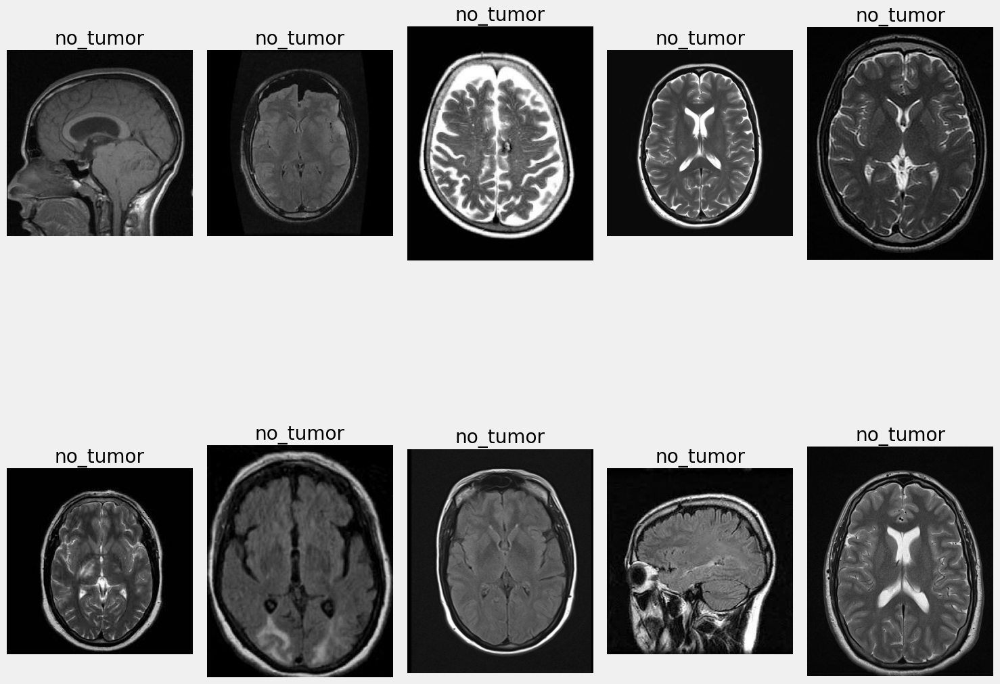

In [ ]:
# Assuming 'image_files' list is already populated from the previous code block

# Display the first 10 images
print("\nDisplaying the first 10 images:")

plt.figure(figsize=(15, 15))
for i in range(min(10, len(image_files))):
    try:
        img_path = image_files[i]
        img = Image.open(img_path)
        plt.subplot(2, 5, i + 1) # Create a 2x5 grid of subplots
        plt.imshow(img)
        plt.title(os.path.basename(os.path.dirname(img_path))) # Show the label (folder name) as title
        plt.axis('off') # Hide the axes
    except Exception as e:
        print(f"  - Could not display image {image_files[i]}: {e}")

plt.tight_layout() # Adjust layout to prevent titles overlapping
plt.show()

In [ ]:
#Geração da dimensão das imagens para entender qual será feito o redimensionamento

# Function to get the dimensions of images in a directory
def get_image_dimensions(directory_path):
    dimensions = {}
    for root, _, files in os.walk(directory_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(root, file)
                try:
                    with Image.open(img_path) as img:
                        dim = img.size  # Returns a tuple (width, height)
                        if dim in dimensions:
                            dimensions[dim] += 1
                        else:
                            dimensions[dim] = 1
                except Exception as e:
                    print(f"Could not open or process image {img_path}: {e}")
    return dimensions

# Get the dimensions for images in the training directory
image_dimensions = get_image_dimensions(data_dir)

print("\nImage dimensions found in the dataset:")
if image_dimensions:
    for dim, count in image_dimensions.items():
        print(f"  - {dim[0]}x{dim[1]}: {count} images")
else:
    print("  No image dimensions found.")



Image dimensions found in the dataset:
  - 236x236: 46 images
  - 210x264: 1 images
  - 630x630: 14 images
  - 220x275: 4 images
  - 225x225: 30 images
  - 201x251: 8 images
  - 550x664: 1 images
  - 416x512: 3 images
  - 236x251: 4 images
  - 255x236: 1 images
  - 450x504: 1 images
  - 212x236: 1 images
  - 210x234: 1 images
  - 512x512: 2309 images
  - 497x398: 1 images
  - 733x781: 1 images
  - 208x278: 1 images
  - 600x600: 1 images
  - 210x213: 2 images
  - 442x442: 15 images
  - 420x280: 2 images
  - 220x212: 1 images
  - 724x851: 1 images
  - 1280x720: 1 images
  - 850x745: 1 images
  - 208x242: 2 images
  - 359x449: 1 images
  - 219x211: 1 images
  - 236x221: 1 images
  - 234x234: 1 images
  - 236x300: 2 images
  - 447x251: 1 images
  - 350x350: 10 images
  - 1024x830: 1 images
  - 235x257: 2 images
  - 330x220: 1 images
  - 227x300: 1 images
  - 504x488: 1 images
  - 262x244: 1 images
  - 208x248: 1 images
  - 224x286: 1 images
  - 236x357: 4 images
  - 233x210: 2 images
  - 

É possivel observar que o dataset tem dimensões variadas, contendo imagens de 1356x1356, o que para o nosso desempenho computacional é inviavel de manter algo tem alto, então será escolhido 128X128

# Data Preparation

## ImageFolder

Foi realizada a alteração para ter somente 1 canal, visto que a foto é preto e branca

In [ ]:
from torchvision.transforms.v2 import Compose, ToImage, Normalize, ToPILImage, Resize, ToDtype, Grayscale

temp_transform = Compose([
    Resize((128, 128)),  # Resize each image to 64x64 by specifying both height and width
    ToPILImage(), # Convert to PIL image first to handle potential format issues before grayscale
    ToImage(), # Convert to a tensor
    Grayscale(num_output_channels=1), # Convert to grayscale (1 channel)
    ToDtype(torch.float32, scale=True) # Cast to float32 and normalize pixel range
])

# Create an ImageFolder dataset from the 'rps' directory
# Images are grouped by subfolder name as class labels, and each image is transformed
temp_dataset = ImageFolder(
    root=data_dir, # Use the correct path to the dataset
    transform=temp_transform          # Apply the preprocessing pipeline to every image
)

In [ ]:
# the second element of this tuple is the label
temp_dataset[0][0].shape, temp_dataset[0][1]

(torch.Size([1, 128, 128]), 0)

In [ ]:
temp_dataset[0][0]

Image([[[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]]], )

In [ ]:
# Get total number of samples in the dataset
dataset_size = len(temp_dataset)
print(f"Dataset size: {dataset_size} images")

# Get number of classes
num_classes = len(temp_dataset.classes)
print(f"Number of classes: {num_classes}")

Dataset size: 2870 images
Number of classes: 4


## Standardization

Processo de estandardização (ou normalização) do conjunto de dados de treinamento.

In [ ]:
temp_loader = DataLoader(temp_dataset, batch_size=16)

In [ ]:
# Each column represents a channel
# first row is the number of data points
# second row is the the sum of mean values
# third row is the sum of standard deviations
first_images, first_labels = next(iter(temp_loader))
Architecture.statistics_per_channel(first_images, first_labels)

tensor([[16.0000],
        [ 2.8879],
        [ 2.5447]])

In [ ]:
# We can leverage the loader_apply() method to get the sums for the whole dataset:
results = Architecture.loader_apply(temp_loader, Architecture.statistics_per_channel)
results

tensor([[2870.0000],
        [ 505.2393],
        [ 482.6058]])

In [ ]:
505.2393/2870

0.17604156794425088

In [ ]:
482.6058/2870

0.16815533101045296

In [ ]:
# we can compute the average mean value and the average standard deviation, per channel.
# Better yet, let’s make it a method that takes a data loader and
# returns an instance of the Normalize() transform
normalizer = Architecture.make_normalizer(temp_loader)
normalizer

Normalize(mean=[tensor(0.1760)], std=[tensor(0.1682)], inplace=False)

## The Real Datasets

In [ ]:
# Define a pipeline of image transformations
from torchvision.transforms.v2 import Grayscale

composer = Compose([
    Resize((128,128)),                         # Resize to 128x128
    ToImage(),                          # Convert to PIL Image
    Grayscale(num_output_channels=1),   # Convert to grayscale with 1 channel
    ToDtype(torch.float32, scale=True), # Cast to float32 and normalize to [0,1]
    normalizer                          # Apply custom normalization transform
])

# Instantiate training and validation datasets from folders:
# - 'Training' contains subfolders per class for training
# - 'Testing' likewise for validation
train_data = ImageFolder(root=os.path.join(path, 'Training'), transform=composer)
val_data   = ImageFolder(root=os.path.join(path, 'Testing'), transform=composer)

# Wrap datasets in DataLoaders for batching and shuffling:
# - batch_size=16 yields mini-batches of 16 images
# - shuffle=True randomizes training order each epoch
train_loader = DataLoader(train_data, batch_size=16, shuffle=True)
val_loader   = DataLoader(val_data,   batch_size=16)  # no shuffle for validation

In [ ]:
def figure2(first_images, first_labels):
    fig, axs = plt.subplots(1, 6, figsize=(12, 4))
    # Update titles to match the classes in the brain tumor dataset
    titles = ['glioma_tumor', 'meningioma_tumor', 'no_tumor', 'pituitary_tumor']
    for i in range(min(6, len(first_images))): # Ensure we don't go out of bounds for batches smaller than 6
        image, label = ToPILImage()(first_images[i]), first_labels[i]
        axs[i].imshow(image)
        axs[i].set_xticks([])
        axs[i].set_yticks([])
        # Ensure the label is within the bounds of the updated titles list
        if label < len(titles):
            axs[i].set_title(titles[label], fontsize=12)
        else:
            axs[i].set_title(f'Unknown Label: {label}', fontsize=12) # Handle unexpected labels
    fig.tight_layout()
    return fig

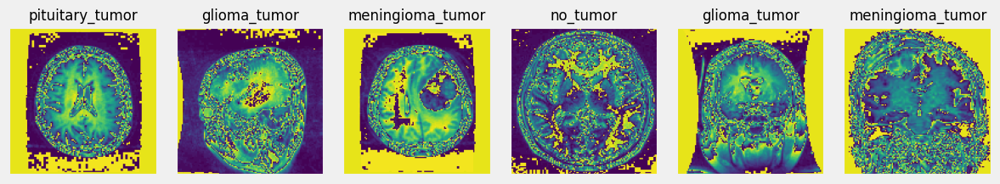

In [ ]:
torch.manual_seed(88)
first_images, first_labels = next(iter(train_loader))

fig = figure2(first_images, first_labels)

### Two-Dimensional Dropout

In [ ]:
def figure9(first_images, seed=17, p=.33):
    torch.manual_seed(seed)
    fig, axs = plt.subplots(1, 3, figsize=(12, 4))
    axs[0].imshow(ToPILImage()(first_images[0]))
    axs[0].set_title('Original Image')
    axs[0].grid(False)
    axs[0].set_xticks([])
    axs[0].set_yticks([])
    axs[1].imshow(ToPILImage()(F.dropout(first_images[:1], p=p)[0]))
    axs[1].set_title('Regular Dropout')
    axs[1].grid(False)
    axs[1].set_xticks([])
    axs[1].set_yticks([])
    axs[2].imshow(ToPILImage()(F.dropout2d(first_images[:1], p=p)[0]))
    axs[2].set_title('Two-Dimensional Dropout')
    axs[2].grid(False)
    axs[2].set_xticks([])
    axs[2].set_yticks([])
    fig.tight_layout()
    return fig

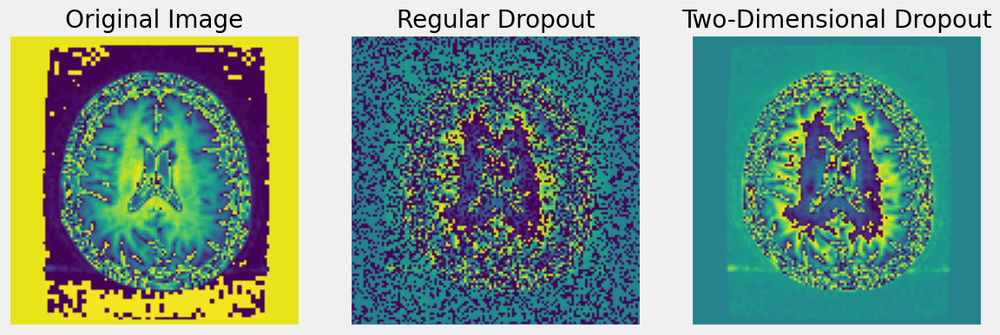

In [ ]:
fig = figure9(first_images)

# Construção da CNN:

TENTANDO COM 32 FEATURE:

In [ ]:
# Parâmetros do modelo
n_feature = 32  # Um bom ponto de partida para o número de filtros
p_dropout = 0.5   # Probabilidade de dropout
num_classes = 4   # Dataset com 4 classes

# Construindo o Modelo Base
base_model = nn.Sequential()

# --- Featurizer (Extrator de Características) ---
# Bloco 1: 1x64x64 -> n_feature x ? x ?
base_model.add_module('conv1', nn.Conv2d(in_channels=1, out_channels=n_feature, kernel_size=3))
base_model.add_module('relu1', nn.ReLU())
base_model.add_module('maxpool1', nn.MaxPool2d(kernel_size=2, stride=2))

# Bloco 2: n_feature x ? x ? -> n_feature x ? x ?
base_model.add_module('conv2', nn.Conv2d(in_channels=n_feature, out_channels=n_feature, kernel_size=3))
base_model.add_module('relu2', nn.ReLU())
base_model.add_module('maxpool2', nn.MaxPool2d(kernel_size=2, stride=2))

# --- Classifier (Classificador) ---
base_model.add_module('flatten', nn.Flatten())

# Calculate the input features for the first linear layer
# by passing a dummy tensor through the featurizer
with torch.no_grad():
    dummy_input = torch.randn(1, 1, 128, 128) # Batch size 1, 1 channel, 28x28 image
    # Pass through conv and pooling layers
    features_before_flatten = base_model[:-1](dummy_input)
    in_features_fc1 = features_before_flatten.view(-1).shape[0]


base_model.add_module('fc1', nn.Linear(in_features=in_features_fc1, out_features=50))
base_model.add_module('relu3', nn.ReLU())
base_model.add_module('dropout', nn.Dropout(p=p_dropout))
base_model.add_module('fc_output', nn.Linear(in_features=50, out_features=num_classes))

print(base_model)

Sequential(
  (conv1): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1))
  (relu1): ReLU()
  (maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1))
  (relu2): ReLU()
  (maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc1): Linear(in_features=28800, out_features=50, bias=True)
  (relu3): ReLU()
  (dropout): Dropout(p=0.5, inplace=False)
  (fc_output): Linear(in_features=50, out_features=4, bias=True)
)


Encontrar taxa de aprendizagem:

In [ ]:
def make_lr_fn(start_lr, end_lr, num_iter):
    # Generates an exponential learning rate schedule
    def lr_fn(iteration):
        # Calculate the logarithmically spaced learning rate
        return np.exp(np.log(start_lr) + (np.log(end_lr) - np.log(start_lr)) * iteration / num_iter)
    return lr_fn

Iniciando treinamento...
Treinamento concluído.


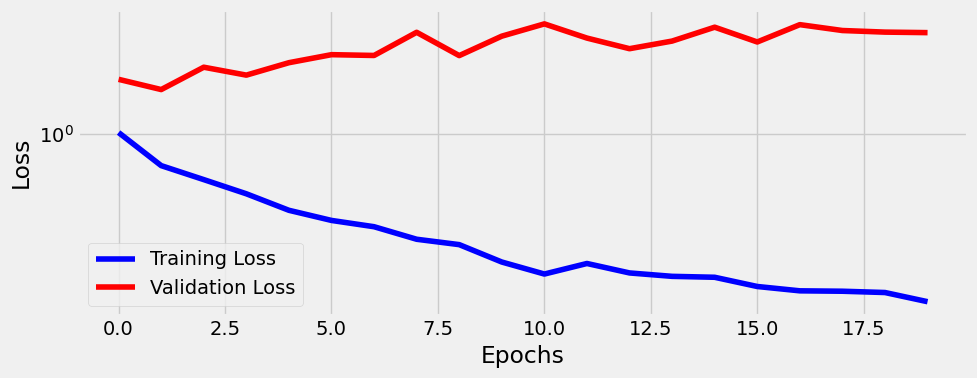

In [ ]:
# Treinamento do Modelo

# Definação do modelo, função de perda e otimizador
model = base_model # Use o base_model corrigido
loss_fn = nn.CrossEntropyLoss() # Use CrossEntropyLoss para classificação multiclasse
optimizer = optim.Adam(model.parameters(), lr=0.001) # Exemplo com Adam, ajuste a LR inicial

# Instância da classe Architecture (recriada após a correção do modelo)
architecture = Architecture(model, loss_fn, optimizer)

# Definação dos DataLoaders
architecture.set_loaders(train_loader, val_loader)

# Parâmetros de treinamento
n_epochs = 20 # Ajuste o número de épocas conforme necessário
seed = 42 # Para reprodutibilidade

# Treinamento do modelo
print("Iniciando treinamento...")
architecture.train(n_epochs, seed=seed)
print("Treinamento concluído.")

# Plot das perdas de treinamento e validação
fig = architecture.plot_losses()
plt.show()

# Hooks:

Visualizando saídas das camadas do Featurizer...


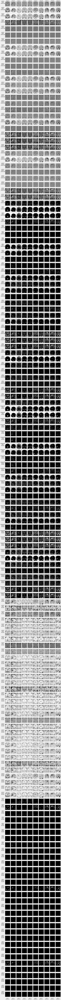


Visualizando saídas das camadas do Classifier...


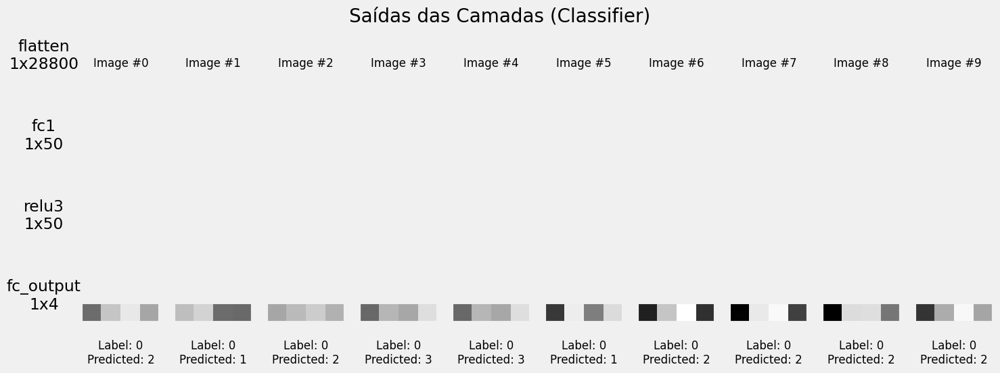

In [ ]:
# 1. Definir as camadas que você quer inspecionar
# (Os nomes devem ser exatamente os mesmos que você usou ao definir o `base_model`)
layers_to_hook = [
    'conv1', 'relu1', 'maxpool1',
    'conv2', 'relu2', 'maxpool2',
    'flatten',
    'fc1', 'relu3', 'fc_output'
]

# 2. Anexar os hooks a essas camadas
# Isso prepara o modelo para "gravar" a saída de cada uma dessas camadas.
architecture.attach_hooks(layers_to_hook=layers_to_hook)

# 3. Pegar um único batch de dados de validação para passar pelo modelo
images_batch, labels_batch = next(iter(val_loader))

# 4. Fazer uma predição com esse batch.
# Ao chamar .predict(), os dados passarão por todas as camadas, os hooks
# serão acionados e as saídas serão salvas no dicionário `architecture.visualization`.
logits = architecture.predict(images_batch)
predicted_labels = np.argmax(logits, axis=1)

# 5. Visualizar as saídas que foram capturadas!
# Sua classe `Architecture` já tem um método pronto para isso.
print("Visualizando saídas das camadas do Featurizer...")
featurizer_layers = ['conv1', 'relu1', 'maxpool1', 'conv2', 'relu2']
feature_maps_fig = architecture.visualize_outputs(
    layers=featurizer_layers,
    y=labels_batch,
    yhat=predicted_labels
)
feature_maps_fig.suptitle("Mapas de Características (Featurizer)", fontsize=20)
plt.show()

print("\nVisualizando saídas das camadas do Classifier...")
classifier_layers = ['flatten', 'fc1', 'relu3', 'fc_output']
classifier_fig = architecture.visualize_outputs(
    layers=classifier_layers,
    y=labels_batch,
    yhat=predicted_labels
)
classifier_fig.suptitle("Saídas das Camadas (Classifier)", fontsize=20)
plt.show()


# 6. É MUITO IMPORTANTE remover os hooks após o uso!
# Se não removidos, eles podem deixar seu código mais lento em execuções futuras.
architecture.remove_hooks()

# Acurária e Matriz de Confusão:


Acurácia total de Treinamento: 2845/2870 (99.13%)

Acurácia de Treinamento por Classe:
Classe 0: 824/826 (99.76%)
Classe 1: 801/822 (97.45%)
Classe 2: 394/395 (99.75%)
Classe 3: 826/827 (99.88%)

Acurácia total de Validação: 299/394 (75.89%)

Acurácia de Validação por Classe:
Classe 0: 23/100 (23.00%)
Classe 1: 105/115 (91.30%)
Classe 2: 105/105 (100.00%)
Classe 3: 66/74 (89.19%)


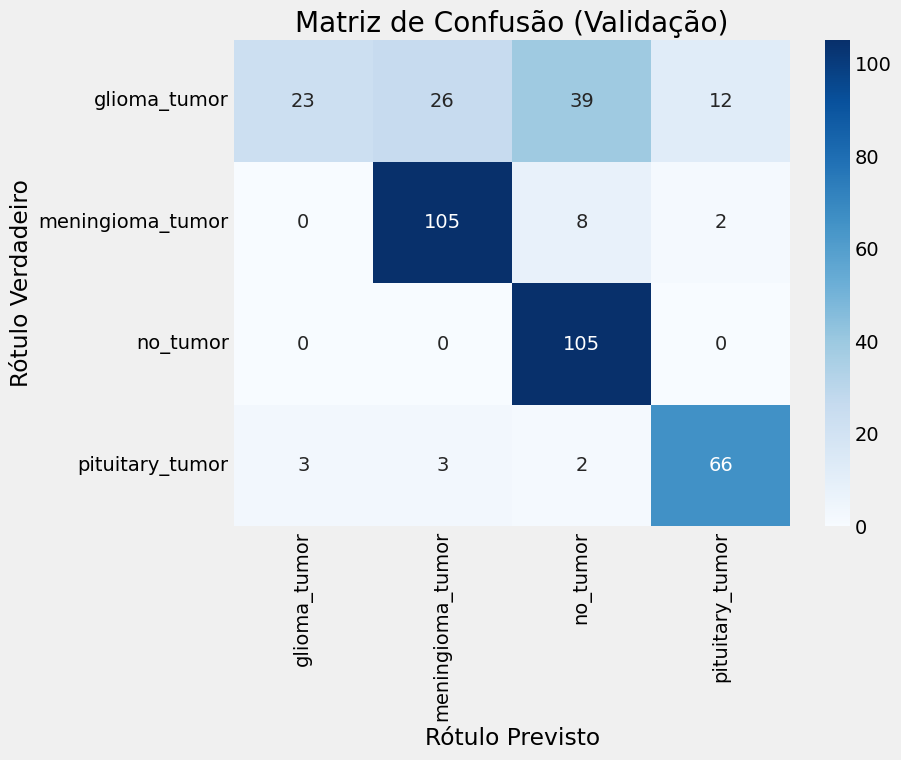

In [ ]:
# Calculo da acurácia total para o conjunto de treinamento
train_correct = Architecture.loader_apply(train_loader, architecture.correct)
total_train_correct = train_correct.sum(axis=0)
overall_train_accuracy = total_train_correct[0].item() / total_train_correct[1].item()

print(f"\nAcurácia total de Treinamento: {total_train_correct[0].item()}/{total_train_correct[1].item()} ({overall_train_accuracy*100:.2f}%)")

# Calculo da acurácia por classe para o conjunto de treinamento
print("\nAcurácia de Treinamento por Classe:")
for i in range(num_classes):
    n_correct = train_correct[i][0].item()
    n_class = train_correct[i][1].item()
    if n_class > 0:
        print(f"Classe {i}: {n_correct}/{n_class} ({n_correct/n_class*100:.2f}%)")
    else:
        print(f"Classe {i}: {n_correct}/{n_class} (N/A - nenhuma amostra nesta classe)")

# Calculo da acurácia total para o conjunto de validação
val_correct = Architecture.loader_apply(val_loader, architecture.correct)
total_val_correct = val_correct.sum(axis=0)
overall_val_accuracy = total_val_correct[0].item() / total_val_correct[1].item()

print(f"\nAcurácia total de Validação: {total_val_correct[0].item()}/{total_val_correct[1].item()} ({overall_val_accuracy*100:.2f}%)")

# Calculo da acurácia por classe para o conjunto de validação
print("\nAcurácia de Validação por Classe:")
for i in range(num_classes):
    n_correct = val_correct[i][0].item()
    n_class = val_correct[i][1].item()
    if n_class > 0:
        print(f"Classe {i}: {n_correct}/{n_class} ({n_correct/n_class*100:.2f}%)")
    else:
        print(f"Classe {i}: {n_correct}/{n_class} (N/A - nenhuma amostra nesta classe)")

# --- Matriz de Confusão ---
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Função para obter todas as previsões e rótulos verdadeiros de um loader
def get_predictions(loader, architecture):
    architecture.model.eval() # Set model to evaluation mode
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for x_batch, y_batch in loader:
            x_batch = x_batch.to(architecture.device)
            y_batch = y_batch.to(architecture.device)
            yhat = architecture.model(x_batch)

            # Assuming multiclass classification with CrossEntropyLoss
            _, predicted = torch.max(yhat, 1)

            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(y_batch.cpu().numpy())
    architecture.model.train() # Set model back to train mode
    return all_labels, all_preds

# Obter previsões e rótulos verdadeiros para o conjunto de validação
val_labels, val_preds = get_predictions(val_loader, architecture)

# Calculo da matriz de confusão
cm = confusion_matrix(val_labels, val_preds)

# Visualização da matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=val_data.classes, yticklabels=val_data.classes)
plt.xlabel('Rótulo Previsto')
plt.ylabel('Rótulo Verdadeiro')
plt.title('Matriz de Confusão (Validação)')
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Calculo dos acertos por classe no conjunto de validação
results_per_class = Architecture.loader_apply(val_loader, architecture.correct)
print("Acertos por classe (Acertos, Total):")
for i, class_name in enumerate(val_data.classes):
    print(f"- {class_name}: {results_per_class[i].tolist()}")

# Calculo e plot da Matriz de Confusão
all_preds = []
all_labels = []
architecture.model.eval()
with torch.no_grad():
    for x_batch, y_batch in val_loader:
        logits = architecture.predict(x_batch)
        preds = np.argmax(logits, axis=1)
        all_preds.extend(preds)
        all_labels.extend(y_batch.cpu().numpy())

cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=val_data.classes)


Acertos por classe (Acertos, Total):
- glioma_tumor: [23, 100]
- meningioma_tumor: [105, 115]
- no_tumor: [105, 105]
- pituitary_tumor: [66, 74]
